In [23]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import missingno as msno
from plotly.subplots import make_subplots
import numpy as np
import sys
import os

In [24]:
# Import root module

current_dir = os.getcwd() # Obtener la ruta del directorio actual del notebook
ROOT_PATH = os.path.dirname(current_dir) # Obtener la ruta del directorio superior
sys.path.insert(1, ROOT_PATH) # Insertar la ruta en sys.path

import root 

# Leer los datasets

In [25]:
calidad_so2_path = root.DIR_DATA_RAW + 'Calidad_SO2_2021_2024.csv'
so2_path = root.DIR_DATA_RAW + 'Datos_SO2_2021_2024.csv'
meteorolicas_path = root.DIR_DATA_RAW + 'Datos_Meteo_2021_2024.csv'

In [26]:
calidad_so2 = pd.read_csv(calidad_so2_path)
so2 = pd.read_csv(so2_path)
meteorolicas = pd.read_csv(meteorolicas_path)

In [27]:
meteorolicas

,est,V-GIR-EPM,V-GIR-EPM.1,V-GIR-EPM.2,V-GIR-EPM.3,V-GIR-EPM.4,V-GIR-EPM.5,MED-FISC,MED-FISC.1,MED-FISC.2,...,CEN-TRAF.2,CEN-TRAF.3,CEN-TRAF.4,CEN-TRAF.5,ITA-CJUS,ITA-CJUS.1,ITA-CJUS.2,ITA-CJUS.3,ITA-CJUS.4,ITA-CJUS.5
0,NaN,DViento_SSR,HAire10_SSR,PLiquida_SSR,P_SSR,TAire10_SSR,VViento_SSR,DViento_SSR,HAire10_SSR,PLiquida_SSR,...,PLiquida_SSR,P_SSR,TAire10_SSR,VViento_SSR,DViento_SSR,HAire10_SSR,PLiquida_SSR,P_SSR,TAire10_SSR,VViento_SSR
1,datetime,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2021-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,337.2,72.1,NaN,636.3,20.1,1.2
3,2021-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,326.3,72.6,NaN,636.0,19.8,1.2
4,2021-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,315.9,71.9,NaN,635.6,19.4,0.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32134,2024-08-31 20:00:00,104.968,73.445,0.0,640.9,22.41,0.611,182.11,70.416,0.0,...,0.0,640.016,24.17,0.394,NaN,NaN,NaN,NaN,NaN,NaN
32135,2024-08-31 21:00:00,18.365,76.08,0.0,641.199,21.802,0.731,177.165,71.9,0.0,...,0.0,640.401,23.668,0.505,NaN,NaN,NaN,NaN,NaN,NaN
32136,2024-08-31 22:00:00,43.908,78.425,0.0,641.824,21.465,0.557,182.976,71.922,0.0,...,0.0,640.935,23.632,0.42,NaN,NaN,NaN,NaN,NaN,NaN
32137,2024-08-31 23:00:00,72.45,82.878,0.0,641.697,20.893,0.422,180.947,74.637,0.02,...,0.0,640.865,23.229,0.499,NaN,NaN,NaN,NaN,NaN,NaN


## Procesamiento df meteorologicas

In [28]:


gir = meteorolicas[['est'] + [col for col in meteorolicas.columns if 'V-GIR-EPM' in col]]
fisc = meteorolicas[['est'] + [col for col in meteorolicas.columns if 'MED-FISC' in col]]
traf = meteorolicas[['est'] + [col for col in meteorolicas.columns if 'CEN-TRAF' in col]]
ita = meteorolicas[['est'] + [col for col in meteorolicas.columns if 'ITA-CJUS' in col]]

In [29]:
# Cambiar los nombres de las columnas de cada DataFrame usando la primera fila
gir.columns = gir.iloc[0]  # Usa la primera fila como nombres de columna
gir = gir.drop(0)  # Elimina la primera fila que ya no es necesaria
gir = gir.drop(1).reset_index(drop=True)
gir.columns.values[0] = 'datetime'


fisc.columns = fisc.iloc[0]
fisc = fisc.drop(0)
fisc = fisc.drop(1).reset_index(drop=True)
fisc.columns.values[0] = 'datetime'

traf.columns = traf.iloc[0]
traf = traf.drop(0)
traf = traf.drop(1).reset_index(drop=True)
traf.columns.values[0] = 'datetime'

ita.columns = ita.iloc[0]
ita = ita.drop(0)
ita = ita.drop(1).reset_index(drop=True)
ita.columns.values[0] = 'datetime'

# Opcional: restablece los índices si es necesario
gir.reset_index(drop=True, inplace=True)
fisc.reset_index(drop=True, inplace=True)
traf.reset_index(drop=True, inplace=True)
ita.reset_index(drop=True, inplace=True)


## Convertir indices en datetime

In [30]:
# Convertir la columna 'datetime' a tipo datetime
calidad_so2['datetime'] = pd.to_datetime(calidad_so2['datetime'])
calidad_so2.set_index('datetime', inplace=True)

so2['datetime'] = pd.to_datetime(so2['datetime'])
so2.set_index('datetime', inplace=True)

gir['datetime'] = pd.to_datetime(gir['datetime'])
gir.set_index('datetime', inplace=True)

fisc['datetime'] = pd.to_datetime(fisc['datetime'])
fisc.set_index('datetime', inplace=True)

traf['datetime'] = pd.to_datetime(traf['datetime'])
traf.set_index('datetime', inplace=True)

ita['datetime'] = pd.to_datetime(ita['datetime'])
ita.set_index('datetime', inplace=True)

## Agregar variables del aire 

In [31]:
gir['SO2'] = so2['GIR-EPM']
gir['Calidad_SO2'] = calidad_so2['calidad_GIR-EPM']
gir = gir.apply(pd.to_numeric, errors='coerce')

fisc['SO2'] = so2['MED-FISC']
fisc['Calidad_SO2'] = calidad_so2['calidad_MED-FISC']
fisc = fisc.apply(pd.to_numeric, errors='coerce')

traf['SO2'] = so2['CEN-TRAF']
traf['Calidad_SO2'] = calidad_so2['calidad_CEN-TRAF']
traf = traf.apply(pd.to_numeric, errors='coerce')

ita['SO2'] = so2['ITA-CJUS']
ita['Calidad_SO2'] = calidad_so2['calidad_ITA-CJUS']
ita = ita.apply(pd.to_numeric, errors='coerce')

In [39]:
fisc.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 32137 entries, 2021-01-01 00:00:00 to 2024-09-01 00:00:00
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   DViento_SSR   25396 non-null  float64
 1   HAire10_SSR   25375 non-null  float64
 2   PLiquida_SSR  25375 non-null  float64
 3   P_SSR         25375 non-null  float64
 4   TAire10_SSR   25375 non-null  float64
 5   VViento_SSR   25396 non-null  float64
 6   SO2           9881 non-null   float64
 7   Calidad_SO2   32137 non-null  float64
dtypes: float64(8)
memory usage: 2.2 MB


In [40]:
fisc.columns

Index(['DViento_SSR', 'HAire10_SSR', 'PLiquida_SSR', 'P_SSR', 'TAire10_SSR',
       'VViento_SSR', 'SO2', 'Calidad_SO2'],
      dtype='object', name=0)

In [44]:
fisc2 = fisc.copy()

In [45]:
fisc2.replace(0, np.nan, inplace=True)

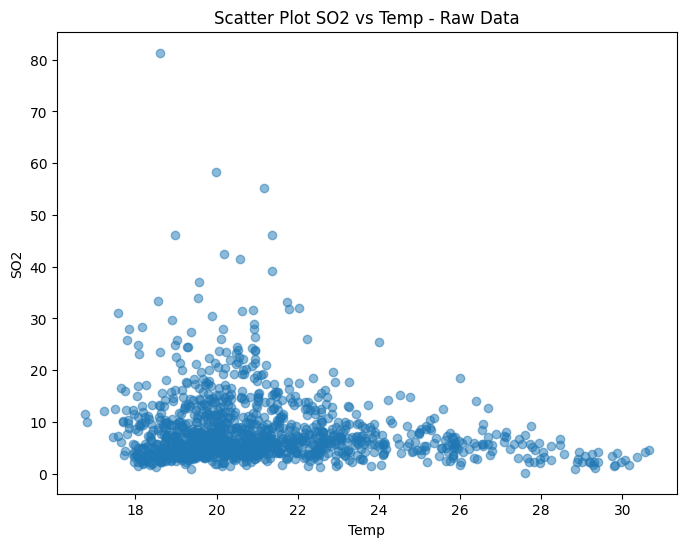

In [46]:
plt.figure(figsize=(8, 6))
plt.scatter(fisc2.dropna()['TAire10_SSR'], fisc2.dropna()['SO2'], alpha=0.5)
plt.xlabel('Temp')
plt.ylabel('SO2')
plt.title('Scatter Plot SO2 vs Temp - Raw Data')
plt.show()

In [ ]:
traf.replace(0, np.nan, inplace=True)

## Agregar variables de calidad

In [33]:
ita_pross_path = root.DIR_DATA_STAGE + 'itagui.pkl'
traf_pross_path = root.DIR_DATA_STAGE + 'trafico.pkl'
fisc_pross_path = root.DIR_DATA_STAGE + 'fiscalia.pkl'
gir_pross_path = root.DIR_DATA_STAGE + 'girardota.pkl'

ita.to_pickle(ita_pross_path)
traf.to_pickle(traf_pross_path)
fisc.to_pickle(fisc_pross_path)
gir.to_pickle(gir_pross_path) 

# Descripcion de los datos

In [12]:
calidad_so2.describe()

,calidad_CEN-TRAF,calidad_ITA-CJUS,calidad_MED-FISC,calidad_GIR-EPM
count,32137.000000,32137.000000,32137.000000,32137.000000
mean,2.239437,1.570514,1.500933,1.756802
std,1.018045,0.784292,1.144041,1.225730
min,1.000000,1.000000,1.000000,1.000000
25%,1.000000,1.000000,1.000000,1.000000
50%,2.500000,1.000000,1.000000,1.000000
75%,2.500000,2.500000,1.000000,2.200000
max,4.310000,4.310000,4.310000,4.310000


In [13]:
# Obtener la fecha de inicio y la fecha final
fecha_inicio = so2.index.min()
fecha_final = so2.index.max()

print("Fecha de inicio:", fecha_inicio)
print("Fecha final:", fecha_final)

Fecha de inicio: 2021-01-01 00:00:00
Fecha final: 2024-09-01 00:00:00


# Calidad de los datos

## Completitud

### Datos SO2 4 estaciones

<Axes: >

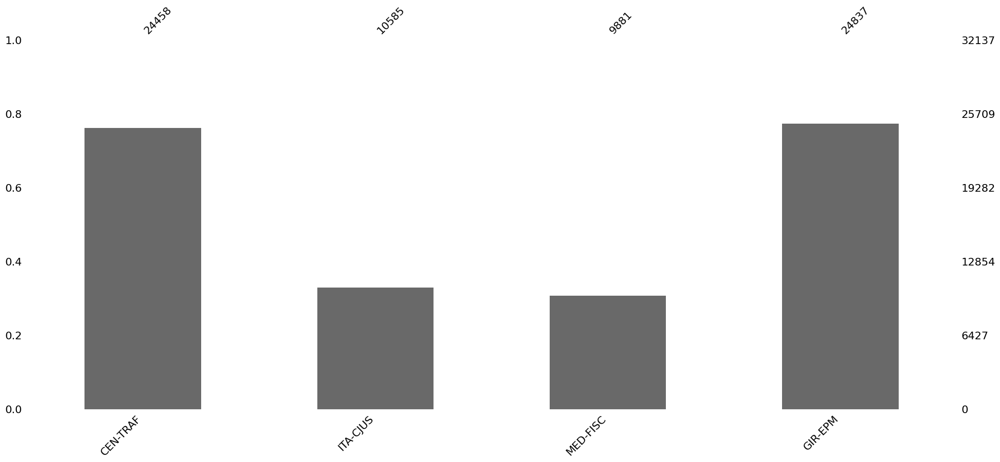

In [14]:
msno.bar(so2)

<Axes: >

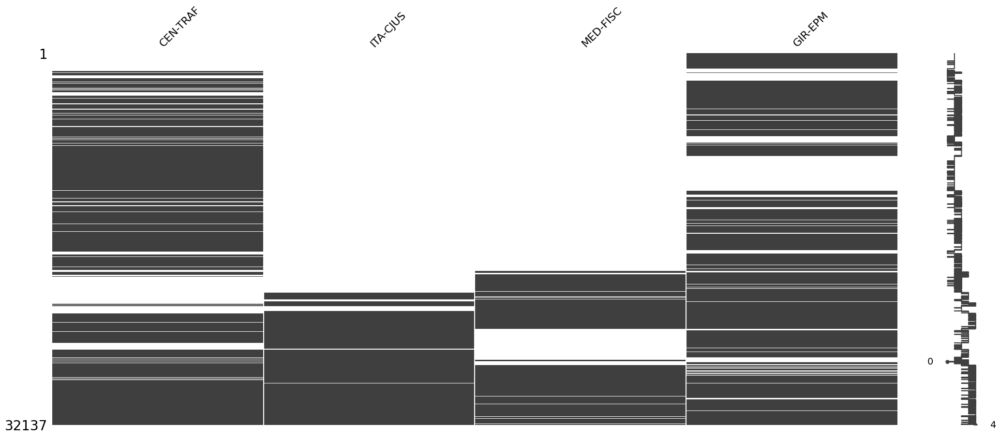

In [15]:
msno.matrix(so2)

c:\Maestria\Trabajo de grado\repositorio\.venv\lib\site-packages\missingno\missingno.py:61: UserWarning: Plotting a sparkline on an existing axis is not currently supported. To remove this warning, set sparkline=False.
  warnings.warn(


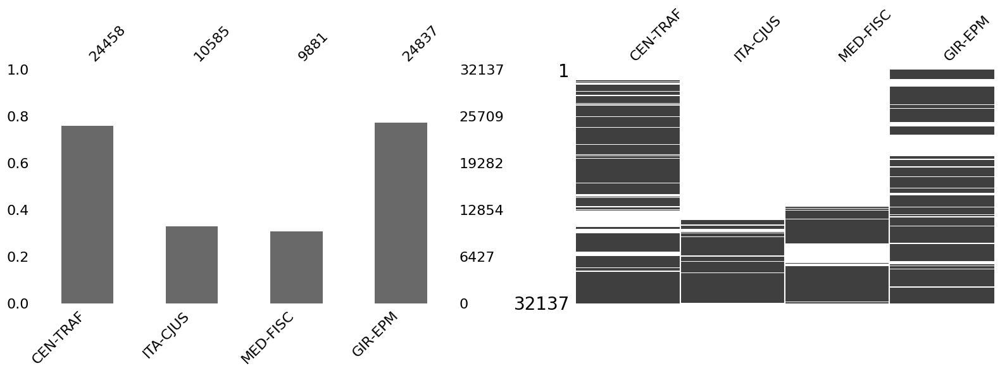

In [16]:
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Gráfico de barras (msno.bar)
msno.bar(so2, ax=axes[0])

# Gráfico de matriz (msno.matrix)
msno.matrix(so2, ax=axes[1])

plt.tight_layout()
plt.show()

<Axes: >

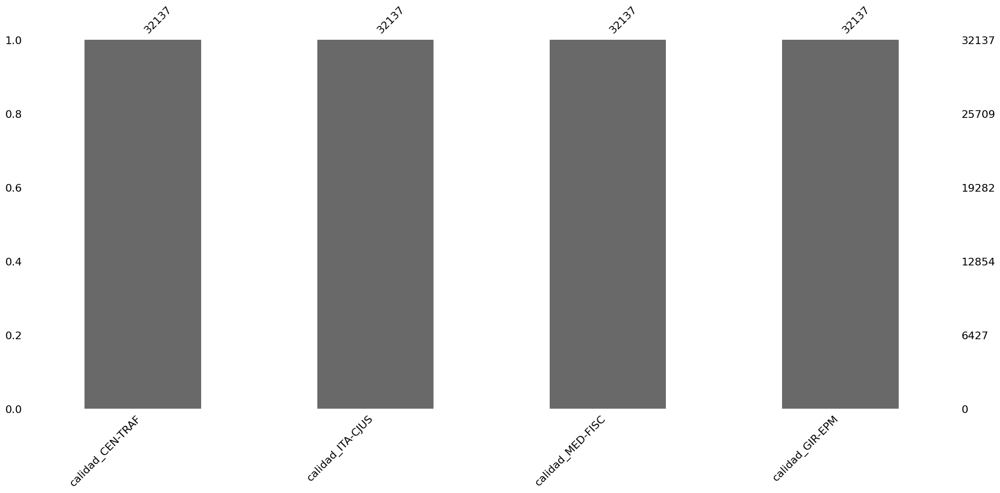

In [17]:
msno.bar(calidad_so2)

### Discriminado por estacion con exogenas|

#### Girardota

In [18]:
df = gir

c:\Maestria\Trabajo de grado\repositorio\.venv\lib\site-packages\missingno\missingno.py:61: UserWarning: Plotting a sparkline on an existing axis is not currently supported. To remove this warning, set sparkline=False.
  warnings.warn(


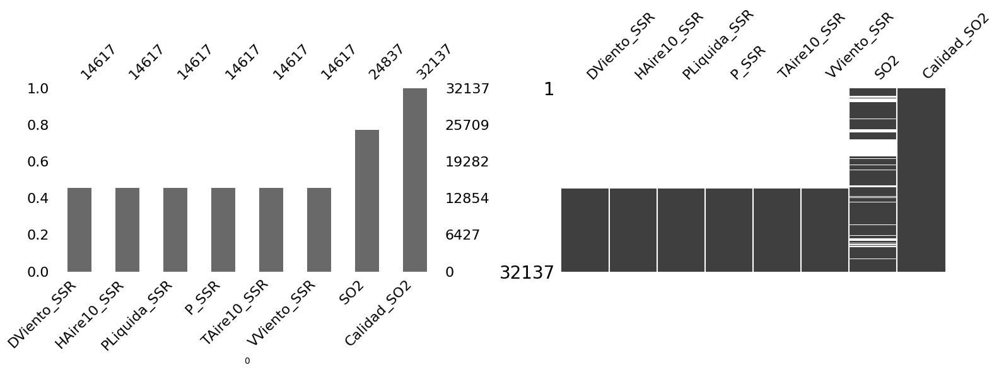

In [19]:
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Gráfico de barras (msno.bar)
msno.bar(df, ax=axes[0])

# Gráfico de matriz (msno.matrix)
msno.matrix(df, ax=axes[1])

plt.tight_layout()
plt.show()

#### Fiscalia

In [20]:
df = fisc

c:\Maestria\Trabajo de grado\repositorio\.venv\lib\site-packages\missingno\missingno.py:61: UserWarning: Plotting a sparkline on an existing axis is not currently supported. To remove this warning, set sparkline=False.
  warnings.warn(


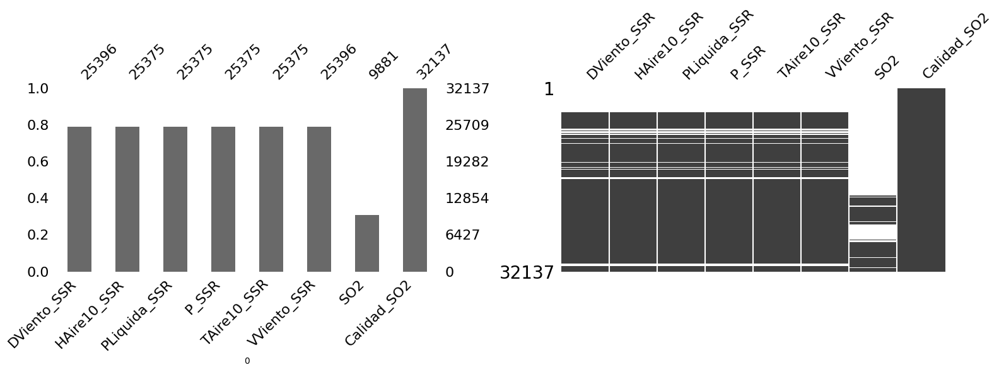

In [21]:
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Gráfico de barras (msno.bar)
msno.bar(df, ax=axes[0])

# Gráfico de matriz (msno.matrix)
msno.matrix(df, ax=axes[1])

plt.tight_layout()
plt.show()

#### Trafico centro

In [22]:
df = traf

c:\Maestria\Trabajo de grado\repositorio\.venv\lib\site-packages\missingno\missingno.py:61: UserWarning: Plotting a sparkline on an existing axis is not currently supported. To remove this warning, set sparkline=False.
  warnings.warn(


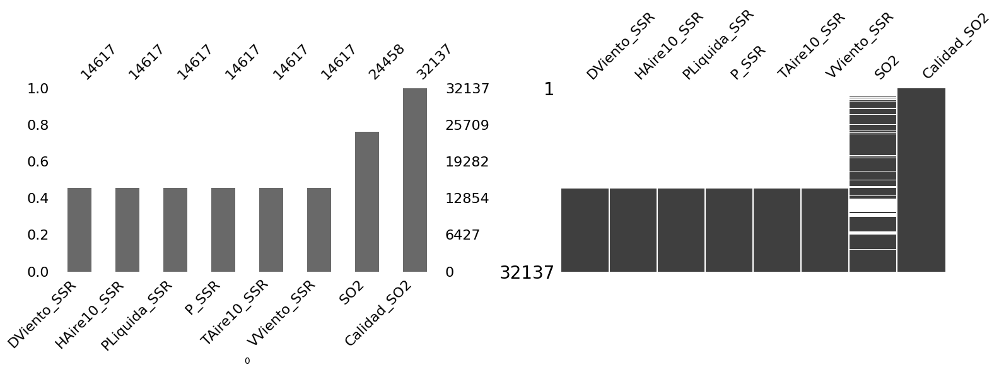

In [23]:
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Gráfico de barras (msno.bar)
msno.bar(df, ax=axes[0])

# Gráfico de matriz (msno.matrix)
msno.matrix(df, ax=axes[1])

plt.tight_layout()
plt.show()

#### Itagui

In [24]:
df = ita

c:\Maestria\Trabajo de grado\repositorio\.venv\lib\site-packages\missingno\missingno.py:61: UserWarning: Plotting a sparkline on an existing axis is not currently supported. To remove this warning, set sparkline=False.
  warnings.warn(


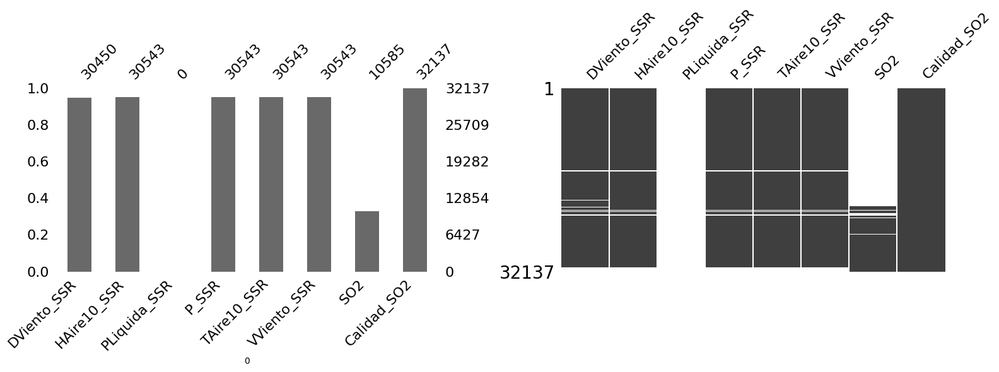

In [25]:
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Gráfico de barras (msno.bar)
msno.bar(df, ax=axes[0])

# Gráfico de matriz (msno.matrix)
msno.matrix(df, ax=axes[1])

plt.tight_layout()
plt.show()

### Grafica SO2 en el tiempo

In [26]:
import plotly.graph_objects as go

# Crear figura
fig = go.Figure()

# Lista de columnas a graficar y colores personalizados
columnas = ['CEN-TRAF', 'ITA-CJUS', 'MED-FISC', 'GIR-EPM']
colores = ['blue', 'red', 'green', 'orange']

# Agregar una línea para cada columna
for col, color in zip(columnas, colores):
    fig.add_trace(go.Scatter(
        x=so2.index, 
        y=so2[col],  
        mode='lines',
        name=col,  # Etiqueta de la serie
        line=dict(color=color)  # Personalizar color de la línea
    ))

# Configurar el diseño de la gráfica
fig.update_layout(
    title="Concentración de SO2 en diferentes estaciones",
    xaxis_title="Fecha y hora",
    yaxis_title="SO2 (ug/m³)",
    height=600,  # Altura de la gráfica
    width=1000,  # Ancho de la gráfica
    legend_title="Estaciones"
)

# Mostrar la figura
fig.show()


In [27]:
calidad_so2

,calidad_CEN-TRAF,calidad_ITA-CJUS,calidad_MED-FISC,calidad_GIR-EPM
datetime,,,,
2021-01-01 00:00:00,1.0,1.0,1.0,1.0
2021-01-01 01:00:00,1.0,1.0,1.0,1.0
2021-01-01 02:00:00,1.0,1.0,1.0,1.0
2021-01-01 03:00:00,1.0,1.0,1.0,1.0
2021-01-01 04:00:00,1.0,1.0,1.0,1.0
...,...,...,...,...
2024-08-31 20:00:00,1.0,2.5,1.0,1.0
2024-08-31 21:00:00,1.0,2.5,1.0,1.0
2024-08-31 22:00:00,1.0,2.5,1.0,1.0


In [28]:
fig = go.Figure()

# Agregar la línea para la columna 'cen-traf'
fig.add_trace(go.Scatter(
    x=so2.index, 
    y=so2['CEN-TRAF'],  # Solo la columna específica
    mode='lines',
    name='cen-traf',  # Etiqueta de la serie
    line=dict(color='blue')  # Personalizar color de la línea
))

# Añadir título y etiquetas a los ejes
fig.update_layout(
    yaxis_title="SO2 (ug/m3)",
    height=600,  # Altura de la gráfica
    width=1000   # Ancho de la gráfica
)

# Mostrar la figura
fig.show()

### Grafico frecuencia de calidad

In [30]:
import plotly.graph_objects as go

# Crear la figura
fig = go.Figure()

# Lista de columnas a graficar y colores personalizados
columnas = ['calidad_CEN-TRAF', 'calidad_ITA-CJUS', 'calidad_MED-FISC', 'calidad_GIR-EPM']
colores = ['blue', 'red', 'green', 'orange']

# Agregar un histograma para cada columna de calidad
for col, color in zip(columnas, colores):
    fig.add_trace(go.Histogram(
        x=calidad_so2[col],  # Datos de calidad para cada estación
        nbinsx=10,  # Número de bins
        marker_color=color,  # Color de las barras
        name=col  # Etiqueta de la serie
    ))

# Configurar el diseño del gráfico
fig.update_layout(
    title="Distribución de la Calidad del Aire en Diferentes Estaciones",
    xaxis_title="Calidad",
    yaxis_title="Frecuencia",
    bargap=0.1,  # Espaciado entre barras
    barmode='overlay',  # Superposición de histogramas para comparación
    height=600,  # Altura de la gráfica
    width=800,   # Ancho de la gráfica
    legend_title="Estaciones"
)

# Mostrar la figura
fig.show()


In [31]:
import plotly.graph_objects as go

# Crear figura
fig = go.Figure()

# Lista de columnas a graficar y colores personalizados
columnas = ['calidad_CEN-TRAF', 'calidad_ITA-CJUS', 'calidad_MED-FISC', 'calidad_GIR-EPM']
colores = ['blue', 'red', 'green', 'orange']

# Agregar una línea para cada columna
for col, color in zip(columnas, colores):
    fig.add_trace(go.Scatter(
        x=calidad_so2.index, 
        y=calidad_so2[col],  
        mode='lines',
        name=col,  # Etiqueta de la serie
        line=dict(color=color)  # Personalizar color de la línea
    ))

# Configurar el diseño de la gráfica
fig.update_layout(
    title="Concentración de SO2 en diferentes estaciones",
    xaxis_title="Fecha y hora",
    yaxis_title="SO2 (ug/m³)",
    height=600,  # Altura de la gráfica
    width=1000,  # Ancho de la gráfica
    legend_title="Estaciones"
)

# Mostrar la figura
fig.show()

In [32]:
import plotly.graph_objects as go

# Crear el histograma
fig = go.Figure()

# Agregar el histograma para 'calidad_CEN-TRAF'
fig.add_trace(go.Histogram(
    x=calidad_so2['calidad_CEN-TRAF'],  # Datos para el histograma
    nbinsx=10,  # Número de bins
    marker_color='blue'  # Color de las barras
))

# Configurar el diseño
fig.update_layout(
    xaxis_title="Calidad",
    yaxis_title="Frecuencia",
    bargap=0.1,  # Espaciado entre barras
    height=600,  # Altura de la gráfica
    width=800    # Ancho de la gráfica
)

# Mostrar la figura
fig.show()

### Grafico variables exogenas

In [33]:
df = traf.copy()

In [34]:
# Encontrar el primer índice (fecha) sin valores nulos
first_non_null_date = df.dropna(how='all').index.min()

# Mostrar el resultado
print("La primera fecha sin datos nulos es:", first_non_null_date)

La primera fecha sin datos nulos es: 2021-01-01 00:00:00


In [35]:
df.describe()

,DViento_SSR,HAire10_SSR,PLiquida_SSR,P_SSR,TAire10_SSR,VViento_SSR,SO2,Calidad_SO2
count,14617.000000,14617.000000,14617.000000,14617.000000,14617.000000,14617.000000,24458.000000,32137.000000
mean,176.989232,71.251836,0.070932,635.659083,23.628160,0.418208,10.062051,2.239437
std,80.877671,18.204011,0.381093,50.057873,4.209686,0.238296,9.631975,1.018045
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,145.723000,58.449000,0.000000,638.549000,20.742000,0.226000,4.233650,1.000000
50%,161.139000,75.739000,0.000000,639.751000,22.832000,0.406000,7.178781,2.500000
75%,197.710000,85.357000,0.000000,640.721000,26.594000,0.576000,12.177042,2.500000
max,359.994000,100.000000,9.760000,643.940000,34.393000,1.683000,106.456919,4.310000


In [36]:
df = df.apply(pd.to_numeric, errors='coerce')
df_filtered = df[df.index >= first_non_null_date]

# Crear un subplot de 3 filas y 2 columnas
fig = make_subplots(
    rows=3, cols=2,
    subplot_titles=["Dirección del viento", "Humedad del aire [%]", "Presion liquida", "Presion [hPa]", "Temperatura [°C] ", "Vel Viento [m/s]"],
    shared_xaxes=True,  # Las gráficas compartirán el eje x
    vertical_spacing=0.1,  # Espaciado vertical entre las subgráficas
)

# Lista de las columnas del DataFrame
columnas = ['DViento_SSR', 'HAire10_SSR', 'PLiquida_SSR', 'P_SSR', 'TAire10_SSR', 'VViento_SSR']

# Crear una gráfica para cada columna
for i, columna in enumerate(columnas):
    row = i // 2 + 1  # Fila
    col = i % 2 + 1  # Columna
    
    fig.add_trace(
        go.Scatter(
            x=df_filtered.index,  # Usar el índice datetime
            y=df_filtered[columna],  # Los valores de la columna
            mode='lines',
            name=columna
        ),
        row=row, col=col  # Asignar la gráfica a la fila y columna correspondientes
    )

# Ajustar el diseño
fig.update_layout(
    height=800,  # Altura total de la figura
    width=1000,  # Ancho total de la figura
    showlegend=False  # No mostrar leyenda en cada gráfico (se puede activar si lo deseas)
)

# Mostrar la figura
fig.show()

In [37]:
fig = go.Figure()

# Agregar la línea para la columna 'cen-traf'
fig.add_trace(go.Scatter(
    x=df.index, 
    y=df['P_SSR'],  # Solo la columna específica
    mode='lines',
    name='cen-traf',  # Etiqueta de la serie
    line=dict(color='blue')  # Personalizar color de la línea
))

# Añadir título y etiquetas a los ejes
fig.update_layout(
    yaxis_title="",
    height=600,  # Altura de la gráfica
    width=1000   # Ancho de la gráfica
)

# Mostrar la figura
fig.show()

## Conformidad

In [38]:
entrada_junio_1 = df.loc['2023-06-01']
entrada_junio_1

,DViento_SSR,HAire10_SSR,PLiquida_SSR,P_SSR,TAire10_SSR,VViento_SSR,SO2,Calidad_SO2
datetime,,,,,,,,
2023-06-01 00:00:00,339.140,84.292,0.70,641.138,20.724,0.164,NaN,3.1
2023-06-01 01:00:00,352.644,90.888,0.55,640.634,19.127,0.039,NaN,3.1
2023-06-01 02:00:00,9.478,93.128,0.87,640.466,18.777,0.118,NaN,3.1
2023-06-01 03:00:00,338.482,93.715,1.02,640.428,18.671,0.280,NaN,3.1
2023-06-01 04:00:00,297.764,95.376,0.83,640.552,18.473,0.063,NaN,3.1
2023-06-01 05:00:00,328.491,95.116,0.34,640.840,18.403,0.061,NaN,3.1
2023-06-01 06:00:00,333.377,94.000,0.10,641.356,18.544,0.028,NaN,3.1
2023-06-01 07:00:00,290.790,92.680,0.28,641.775,19.158,0.086,NaN,3.1
2023-06-01 08:00:00,306.630,91.173,0.08,642.113,20.169,0.109,NaN,3.1


## Duplicidad

In [39]:
df = ita

In [40]:
duplicados = df.duplicated().sum()
duplicados

np.int64(790)

In [41]:
# Suponiendo que tienes un DataFrame llamado df
duplicados = df[df.duplicated(keep=False)]  # Detecta duplicados sin eliminar ninguna ocurrencia

# Ordenar los duplicados para que aparezcan juntos
duplicados_ordenados = duplicados.sort_values(by=df.columns.tolist())

duplicados_ordenados

,DViento_SSR,HAire10_SSR,PLiquida_SSR,P_SSR,TAire10_SSR,VViento_SSR,SO2,Calidad_SO2
datetime,,,,,,,,
2022-08-17 07:00:00,0.0,78.6,NaN,636.5,17.8,0.0,NaN,1.00
2023-01-02 02:00:00,0.0,78.6,NaN,636.5,17.8,0.0,NaN,1.00
2023-01-07 07:00:00,0.0,78.6,NaN,636.7,17.8,0.0,NaN,1.00
2023-01-19 08:00:00,0.0,78.6,NaN,636.7,17.8,0.0,NaN,1.00
2021-08-01 00:00:00,2.3,63.0,NaN,637.6,21.3,0.8,NaN,1.00
...,...,...,...,...,...,...,...,...
2024-08-30 10:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.31
2024-08-30 11:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.31
2024-08-30 12:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.31


# Correlacion variables exogenas

## Pearson

In [42]:
df = fisc

In [43]:
first_non_null_date = df.dropna(how='all').index.min()
df_filtered_SO2 = df[df.index >= first_non_null_date]

In [44]:
corr_matrix = df_filtered_SO2.corr()

# Crear el mapa de calor usando Plotly
fig = go.Figure(data=go.Heatmap(
    z=corr_matrix.values,  # Los valores de la matriz de correlación
    x=corr_matrix.columns,  # Nombres de las columnas
    y=corr_matrix.columns,  # Nombres de las columnas
    colorscale='Viridis',  # Escala de colores
    zmin=-1, zmax=1,  # Definir los límites de la correlación
    colorbar=dict(title="Correlación"),  # Título de la barra de color
    text=corr_matrix.round(2).values,  # Los valores numéricos de la correlación
    hoverinfo='text',  # Mostrar los números al pasar el ratón
    showscale=True  # Mostrar la escala de colores
))

# Añadir el título y las etiquetas
fig.update_layout(
    height=800,  # Altura de la gráfica
    width=800,   # Ancho de la gráfica
)

# Añadir los números directamente dentro del mapa de calor
fig.update_traces(
    texttemplate="%{text}",  # Muestra el valor numérico de cada celda
    textfont=dict(size=12, color='black', family='Arial'),  # Establece el tamaño y color del texto
    showscale=True
)

# Mostrar la figura
fig.show()

## Spearman

In [45]:
corr_matrix = df_filtered_SO2.corr(method='spearman')

# Crear el mapa de calor usando Plotly
fig = go.Figure(data=go.Heatmap(
    z=corr_matrix.values,  # Los valores de la matriz de correlación
    x=corr_matrix.columns,  # Nombres de las columnas
    y=corr_matrix.columns,  # Nombres de las columnas
    colorscale='Viridis',  # Escala de colores
    zmin=-1, zmax=1,  # Definir los límites de la correlación
    colorbar=dict(title="Correlación"),  # Título de la barra de color
    text=corr_matrix.round(2).values,  # Los valores numéricos de la correlación
    hoverinfo='text',  # Mostrar los números al pasar el ratón
    showscale=True  # Mostrar la escala de colores
))

# Añadir el título y las etiquetas
fig.update_layout(
    height=800,  # Altura de la gráfica
    width=800,   # Ancho de la gráfica
)

# Añadir los números directamente dentro del mapa de calor
fig.update_traces(
    texttemplate="%{text}",  # Muestra el valor numérico de cada celda
    textfont=dict(size=12, color='black', family='Arial'),  # Establece el tamaño y color del texto
    showscale=True
)

# Mostrar la figura
fig.show()

## kendall

In [46]:
corr_matrix = df_filtered_SO2.corr(method='kendall')

# Crear el mapa de calor usando Plotly
fig = go.Figure(data=go.Heatmap(
    z=corr_matrix.values,  # Los valores de la matriz de correlación
    x=corr_matrix.columns,  # Nombres de las columnas
    y=corr_matrix.columns,  # Nombres de las columnas
    colorscale='Viridis',  # Escala de colores
    zmin=-1, zmax=1,  # Definir los límites de la correlación
    colorbar=dict(title="Correlación"),  # Título de la barra de color
    text=corr_matrix.round(2).values,  # Los valores numéricos de la correlación
    hoverinfo='text',  # Mostrar los números al pasar el ratón
    showscale=True  # Mostrar la escala de colores
))

# Añadir el título y las etiquetas
fig.update_layout(
    height=800,  # Altura de la gráfica
    width=800,   # Ancho de la gráfica
)

# Añadir los números directamente dentro del mapa de calor
fig.update_traces(
    texttemplate="%{text}",  # Muestra el valor numérico de cada celda
    textfont=dict(size=12, color='black', family='Arial'),  # Establece el tamaño y color del texto
    showscale=True
)

# Mostrar la figura
fig.show()

# Correlacion entre estaciones

In [47]:
corr_matrix = so2.corr()

# Crear el mapa de calor usando Plotly
fig = go.Figure(data=go.Heatmap(
    z=corr_matrix.values,  # Los valores de la matriz de correlación
    x=corr_matrix.columns,  # Nombres de las columnas
    y=corr_matrix.columns,  # Nombres de las columnas
    colorscale='Viridis',  # Escala de colores
    zmin=-1, zmax=1,  # Definir los límites de la correlación
    colorbar=dict(title="Correlación"),  # Título de la barra de color
    text=corr_matrix.round(2).values,  # Los valores numéricos de la correlación
    hoverinfo='text',  # Mostrar los números al pasar el ratón
    showscale=True  # Mostrar la escala de colores
))

# Añadir el título y las etiquetas
fig.update_layout(
    height=800,  # Altura de la gráfica
    width=800,   # Ancho de la gráfica
)

# Añadir los números directamente dentro del mapa de calor
fig.update_traces(
    texttemplate="%{text}",  # Muestra el valor numérico de cada celda
    textfont=dict(size=12, color='black', family='Arial'),  # Establece el tamaño y color del texto
    showscale=True
)

# Mostrar la figura
fig.show()

## Estacionariedad

In [48]:
# statsmodels
import statsmodels
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import kpss
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose

import warnings

In [49]:
df = fisc.copy()

Test estacionariedad serie original
-------------------------------------
ADF Statistic: -23.387105111336155, p-value: 0.0
KPSS Statistic: 0.55960168515045, p-value: 0.02824286370485361

Test estacionariedad para serie diferenciada (order=1)
--------------------------------------------------
ADF Statistic: -10.49397822928805, p-value: 1.1279681974829833e-18
KPSS Statistic: 0.11005950884666434, p-value: 0.1

Test estacionariedad para serie diferenciada (order=2)
--------------------------------------------------
ADF Statistic: -11.196917274097684, p-value: 2.2942877031086225e-20
KPSS Statistic: 0.09926600590578659, p-value: 0.1


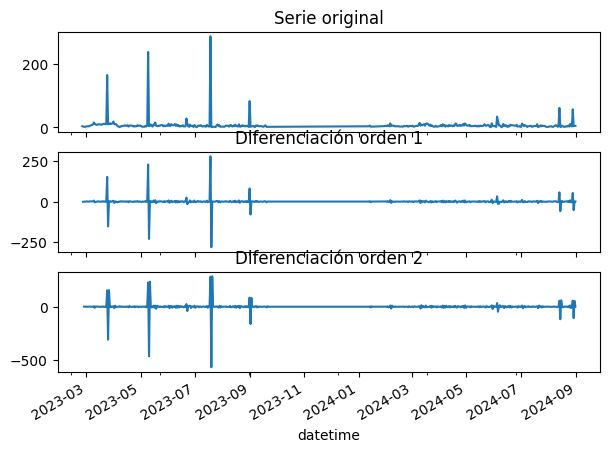

In [50]:
# Test estacionariedad
# ==============================================================================
warnings.filterwarnings("ignore")

datos = df['SO2'].dropna()
datos = datos.asfreq('d')  # Para datos horarios
datos = datos.interpolate(method='linear')

datos_diff_1 = datos.diff().dropna()
datos_diff_2 = datos_diff_1.diff().dropna()

print('Test estacionariedad serie original')
print('-------------------------------------')
adfuller_result = adfuller(datos)
kpss_result = kpss(datos)
print(f'ADF Statistic: {adfuller_result[0]}, p-value: {adfuller_result[1]}')
print(f'KPSS Statistic: {kpss_result[0]}, p-value: {kpss_result[1]}')

print('\nTest estacionariedad para serie diferenciada (order=1)')
print('--------------------------------------------------')
adfuller_result = adfuller(datos_diff_1)
kpss_result = kpss(datos.diff().dropna())
print(f'ADF Statistic: {adfuller_result[0]}, p-value: {adfuller_result[1]}')
print(f'KPSS Statistic: {kpss_result[0]}, p-value: {kpss_result[1]}')

print('\nTest estacionariedad para serie diferenciada (order=2)')
print('--------------------------------------------------')
adfuller_result = adfuller(datos_diff_2)
kpss_result = kpss(datos.diff().diff().dropna())
print(f'ADF Statistic: {adfuller_result[0]}, p-value: {adfuller_result[1]}')
print(f'KPSS Statistic: {kpss_result[0]}, p-value: {kpss_result[1]}')

warnings.filterwarnings("default")

# Gráfico series
# ==============================================================================
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(7, 5), sharex=True)
datos.plot(ax=axs[0], title='Serie original')
datos_diff_1.plot(ax=axs[1], title='Diferenciación orden 1')
datos_diff_2.plot(ax=axs[2], title='Diferenciación orden 2');

# Autocorrelacion

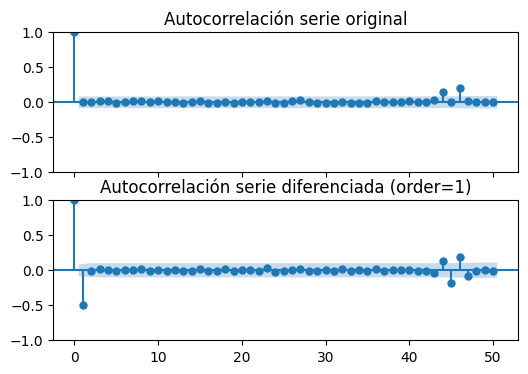

In [51]:
# Grafico de autocorrelación para la serie original y la serie diferenciada
# ==============================================================================
fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(6, 4), sharex=True)
plot_acf(datos, ax=axs[0], lags=50, alpha=0.05)
axs[0].set_title('Autocorrelación serie original')
plot_acf(datos_diff_1, ax=axs[1], lags=50, alpha=0.05)
axs[1].set_title('Autocorrelación serie diferenciada (order=1)');

## Autocorrelacion parcial

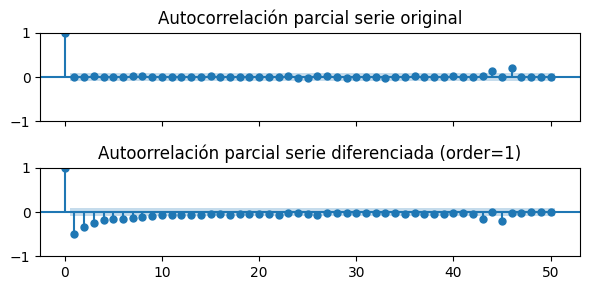

In [52]:
# Autocorrelación parcial para la serie original y la serie diferenciada
# ==============================================================================
fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(6, 3), sharex=True)
plot_pacf(datos, ax=axs[0], lags=50, alpha=0.05)
axs[0].set_title('Autocorrelación parcial serie original')
plot_pacf(datos_diff_1, ax=axs[1], lags=50, alpha=0.05)
axs[1].set_title('Autoorrelación parcial serie diferenciada (order=1)');
plt.tight_layout();

# Descomposicion

In [53]:
datos.info()

<class 'pandas.core.series.Series'>
DatetimeIndex: 555 entries, 2023-02-24 12:00:00 to 2024-08-31 12:00:00
Freq: D
Series name: SO2
Non-Null Count  Dtype  
--------------  -----  
555 non-null    float64
dtypes: float64(1)
memory usage: 8.7 KB


In [54]:
datos.info()

<class 'pandas.core.series.Series'>
DatetimeIndex: 555 entries, 2023-02-24 12:00:00 to 2024-08-31 12:00:00
Freq: D
Series name: SO2
Non-Null Count  Dtype  
--------------  -----  
555 non-null    float64
dtypes: float64(1)
memory usage: 8.7 KB


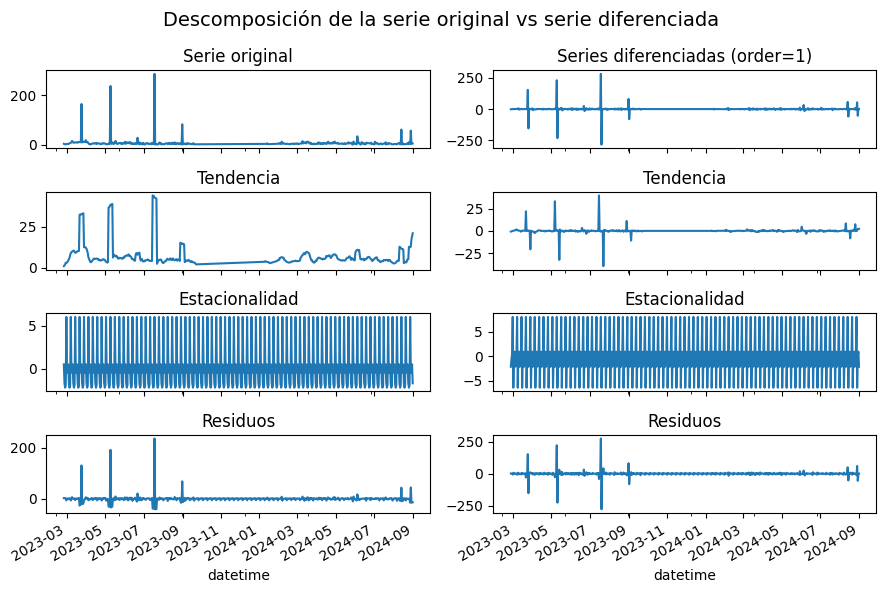

In [55]:
datos = datos.asfreq('d')  # Para datos horarios
datos = datos.interpolate(method='linear')

# Descomposición de la serie original y la serie diferenciada
# ==============================================================================
res_decompose = seasonal_decompose(datos, model='additive', extrapolate_trend='freq')
res_descompose_diff_2 = seasonal_decompose(datos_diff_1, model='additive', extrapolate_trend='freq')

fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(9, 6), sharex=True)
res_decompose.observed.plot(ax=axs[0, 0])
axs[0, 0].set_title('Serie original', fontsize=12)
res_decompose.trend.plot(ax=axs[1, 0])
axs[1, 0].set_title('Tendencia', fontsize=12)
res_decompose.seasonal.plot(ax=axs[2, 0])
axs[2, 0].set_title('Estacionalidad', fontsize=12)
res_decompose.resid.plot(ax=axs[3, 0])
axs[3, 0].set_title('Residuos', fontsize=12)
res_descompose_diff_2.observed.plot(ax=axs[0, 1])
axs[0, 1].set_title('Series diferenciadas (order=1)', fontsize=12)
res_descompose_diff_2.trend.plot(ax=axs[1, 1])
axs[1, 1].set_title('Tendencia', fontsize=12)
res_descompose_diff_2.seasonal.plot(ax=axs[2, 1])
axs[2, 1].set_title('Estacionalidad', fontsize=12)
res_descompose_diff_2.resid.plot(ax=axs[3, 1])
axs[3, 1].set_title('Residuos', fontsize=12)
fig.suptitle('Descomposición de la serie original vs serie diferenciada', fontsize=14)
fig.tight_layout();

# Deteccion de outliers

## Univariables

In [56]:
df = fisc.copy()

Total de outliers detectados en SO2: 809


C:\Users\jgome\AppData\Local\Temp\ipykernel_22268\1520864154.py:23: PendingDeprecationWarning:

vert: bool will be deprecated in a future version. Use orientation: {'vertical', 'horizontal'} instead.



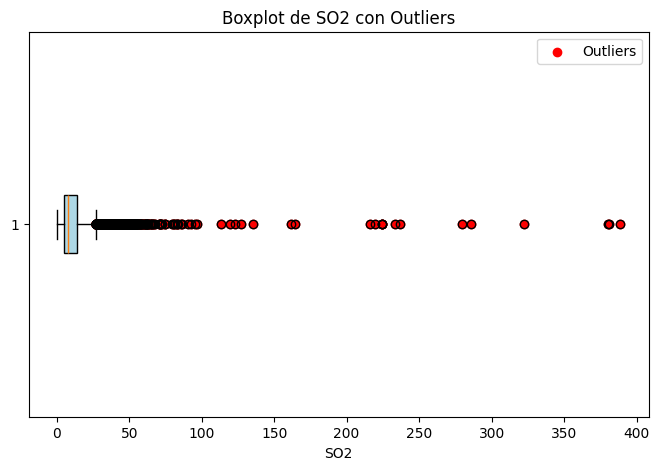

Nuevo DataFrame sin outliers en SO2: 31328 filas


In [57]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


Q1 = df['SO2'].quantile(0.25)
Q3 = df['SO2'].quantile(0.75)
IQR = Q3 - Q1


lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR


outliers_SO2 = (df['SO2'] < lower_bound) | (df['SO2'] > upper_bound)


num_outliers_SO2 = outliers_SO2.sum()
print(f"Total de outliers detectados en SO2: {num_outliers_SO2}")


plt.figure(figsize=(8, 5))
plt.boxplot(df['SO2'].dropna(), vert=False, patch_artist=True, boxprops=dict(facecolor='lightblue'))
plt.scatter(df['SO2'][outliers_SO2], np.ones(sum(outliers_SO2)), color='red', label='Outliers')
plt.xlabel("SO2")
plt.title("Boxplot de SO2 con Outliers")
plt.legend()
plt.show()

# **Eliminar outliers y crear df limpio**
df_clean = df[~outliers_SO2].copy()  # Filtramos solo los valores sin outliers
print(f"Nuevo DataFrame sin outliers en SO2: {df_clean.shape[0]} filas")


c:\Maestria\Trabajo de grado\repositorio\.venv\lib\site-packages\seaborn\categorical.py:700: PendingDeprecationWarning:

vert: bool will be deprecated in a future version. Use orientation: {'vertical', 'horizontal'} instead.



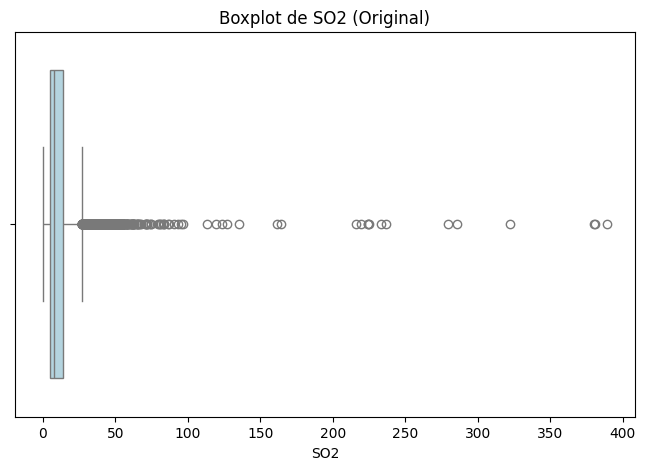

In [58]:
import seaborn as sns
import matplotlib.pyplot as plt
# Configurar el tamaño de la figura
plt.figure(figsize=(8, 5))

# Crear el boxplot con Seaborn
sns.boxplot(x=df["SO2"], color="lightblue")

# Agregar título y etiquetas
plt.title("Boxplot de SO2 (Original)")
plt.xlabel("SO2")

# Mostrar la gráfica
plt.show()

## Multivariables

In [59]:
from scipy.spatial import distance, ConvexHull
from scipy.stats import kurtosis
from sklearn.covariance import EllipticEnvelope

In [60]:
fisc

,DViento_SSR,HAire10_SSR,PLiquida_SSR,P_SSR,TAire10_SSR,VViento_SSR,SO2,Calidad_SO2
datetime,,,,,,,,
2021-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2021-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2021-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2021-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2021-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...
2024-08-31 20:00:00,182.110,70.416,0.00,640.299,23.745,3.961,6.924866,1.0
2024-08-31 21:00:00,177.165,71.900,0.00,640.768,23.306,3.856,5.884357,1.0
2024-08-31 22:00:00,182.976,71.922,0.00,641.253,23.186,4.025,5.354086,1.0


# Remplazo de 0s por nulos

In [61]:
df = fisc.copy()

In [62]:
df.isnull().sum().sum()

np.int64(62786)

In [63]:
df.replace(0, np.nan, inplace=True)

# Drop columnas no significativas

In [64]:
df = df.drop(columns=[#"DViento_SSR"#, "P_SSR", "Calidad_SO2"])

SyntaxError: incomplete input (1449614435.py, line 1)

## Creacion matriz X

In [65]:
#X = df.values

X = df.dropna().values

alfa = 0.01

In [66]:
df

,DViento_SSR,HAire10_SSR,PLiquida_SSR,P_SSR,TAire10_SSR,VViento_SSR,SO2,Calidad_SO2
datetime,,,,,,,,
2021-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2021-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2021-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2021-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2021-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...
2024-08-31 20:00:00,182.110,70.416,NaN,640.299,23.745,3.961,6.924866,1.0
2024-08-31 21:00:00,177.165,71.900,NaN,640.768,23.306,3.856,5.884357,1.0
2024-08-31 22:00:00,182.976,71.922,NaN,641.253,23.186,4.025,5.354086,1.0


## Fast MCD

In [67]:
envelope = EllipticEnvelope(contamination=alfa)  # Contamination is the expected proportion of outliers
envelope.fit(X)
outlier_mcd = envelope.predict(X)

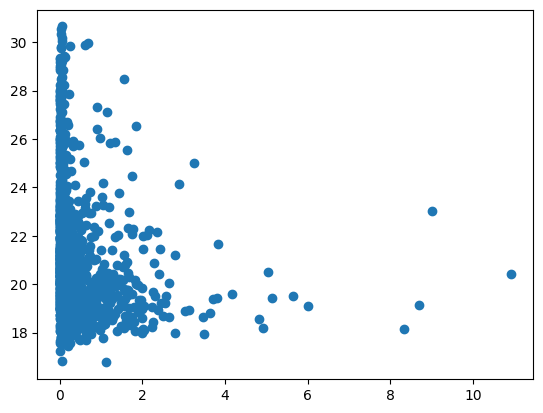

In [68]:
plt.figure('Plot X vs Y')
plt.scatter(X[:,2],X[:,4])

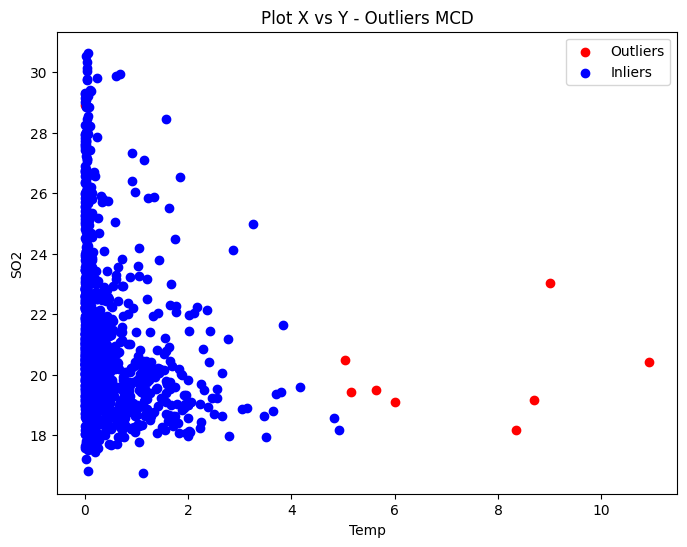

In [69]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.scatter(X[outlier_mcd == -1, 2], X[outlier_mcd == -1, 4], color='red', label='Outliers')
plt.scatter(X[outlier_mcd == 1, 2], X[outlier_mcd == 1, 4], color='blue', label='Inliers')

plt.xlabel("Temp")
plt.ylabel("SO2")
plt.legend()
plt.title("Plot X vs Y - Outliers MCD")
plt.show()


In [70]:
mask = df.dropna().index  # Índices de las filas usadas en X
df_sin_outliers = df.loc[mask][outlier_mcd == 1].copy()

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 32137 entries, 2021-01-01 00:00:00 to 2024-09-01 00:00:00
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   HAire10_SSR   24816 non-null  float64
 1   PLiquida_SSR  4574 non-null   float64
 2   TAire10_SSR   24840 non-null  float64
 3   VViento_SSR   23458 non-null  float64
 4   SO2           9881 non-null   float64
dtypes: float64(5)
memory usage: 2.5 MB


In [ ]:
df_sin_outliers.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1200 entries, 2023-02-26 04:00:00 to 2024-08-31 23:00:00
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   HAire10_SSR   1200 non-null   float64
 1   PLiquida_SSR  1200 non-null   float64
 2   TAire10_SSR   1200 non-null   float64
 3   VViento_SSR   1200 non-null   float64
 4   SO2           1200 non-null   float64
dtypes: float64(5)
memory usage: 56.2 KB


In [ ]:
num_outliers = (outlier_mcd == -1).sum()
print(f'Número de outliers: {num_outliers}')

Número de outliers: 13


## Curtosis

In [ ]:
def outliers_curtosis(matrix, alfa, num_projections = 100):
    # Generate random unit vectors as initial projections
    initial_projections = [np.random.rand(matrix.shape[1]) for _ in range(num_projections)]
    initial_projections = [v / np.linalg.norm(v) for v in initial_projections]

    # Project the data onto the initial projections
    projected_data = [np.dot(matrix, v) for v in initial_projections]

    # Calculate the kurtosis of each projection
    kurtosis_values = [kurtosis(proj) for proj in projected_data]

    # Find the projection with the highest kurtosis
    best_projection_index = np.argmax(kurtosis_values)
    best_projection = projected_data[best_projection_index]
    
    cutoff1 = np.percentile(best_projection,100-(alfa/2)*100)
    cutoff2 = np.percentile(best_projection,(alfa/2)*100)
    
    outliers = ((best_projection < cutoff2)| (best_projection > cutoff1)).astype(int)
    return outliers

In [ ]:
outlier_kur = outliers_curtosis(X, alfa, num_projections = 1000)

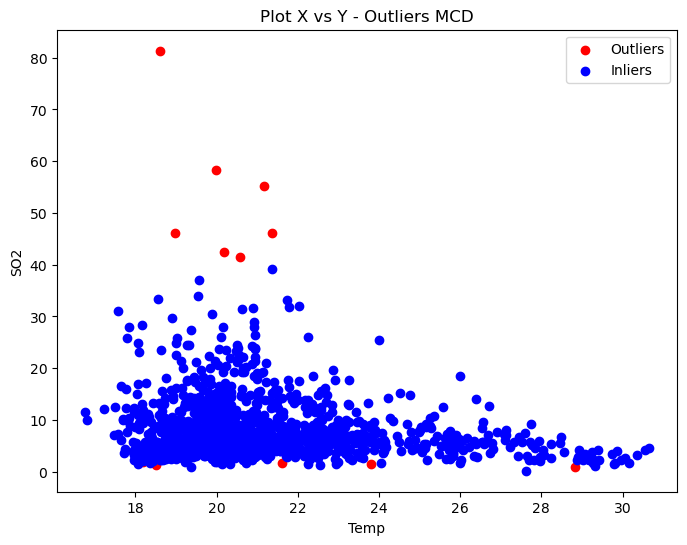

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.scatter(X[outlier_kur == 1, 2], X[outlier_kur == 1, 4], color='red', label='Outliers')
plt.scatter(X[outlier_kur == 0, 2], X[outlier_kur == 0, 4], color='blue', label='Inliers')

plt.xlabel("Temp")
plt.ylabel("SO2")
plt.legend()
plt.title("Plot X vs Y - Outliers MCD")
plt.show()